In [1]:
import numpy as np
import time
import matplotlib.pyplot as plt
import scipy.stats as stats 

### Loading the data:

In [2]:
import scipy.io
mat = scipy.io.loadmat('attfaces.mat')
V=mat['V']

### Plot the matrix of images V : The dataset :

In [3]:
def plot_image_matrix(V, nb_n=20,nb_p=20):

    V_concat = np.zeros((112 * nb_n, 92 * nb_p))
    
    k = 0
    l = 0
    for i in range(nb_n):
        m = 0
        for j in range(nb_p):
            if (k<V.shape[1]):
                V_concat[l: (l + 112), m: (m + 92)
                         ] = np.reshape(V[:, k], (92, 112)).T

            m += 92
            k += 1
        l += 112

    return V_concat

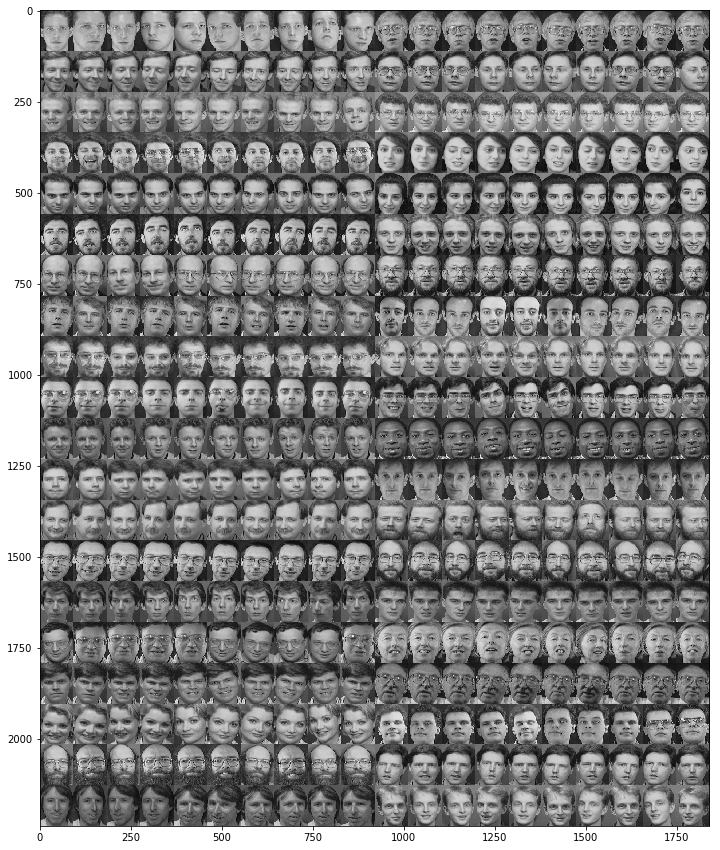

In [4]:
plt.figure(figsize=(15,15))
plt.imshow(plot_image_matrix(V), cmap=plt.cm.gray, interpolation="nearest")

### Question 1 : Implement the EM algorithm that you developed in Question 1.

In [5]:
def EM_Algo(V, beta_w, beta_h, n_iter, K=25, alpha_w=1, alpha_h=1):

    W = np.random.gamma(size=(V.shape[0], K),shape=alpha_w,scale=1./beta_w)
    H = np.random.gamma(size=(K, V.shape[1]),shape=alpha_h,scale=1./beta_h)

    Ow = np.ones((V.shape[0], K))
    Oh = np.ones((K, V.shape[1]))
    O = np.ones((V.shape[0], V.shape[1]))

    for t in range(n_iter):
        V_hat = W.dot(H)
#         print('V_hat = ',V_hat,'\n #########################')
        
        W_old=W
        W = (alpha_w-1) * Ow + W * ((V / V_hat).dot(H.T))
        W = W / ((beta_w*Ow)+O.dot(H.T))
#         print('W = ',W,'\n #########################')
        
        H = (alpha_h-1)*Oh+H*(W_old.T.dot((V / V_hat)))
        H = H / ((beta_h*Oh)+W_old.T.dot(O))
#         print('H = ',H ,'\n #########################')

        
    return W,H 

### Question 2 : Run the algorithm on the face dataset. Set K = 25, α w = α h = 1. Try different values for β w and β h . Visualize the columns of estimated W matrices. What do you observe when you change the parameters?

In [6]:
def visualize(param_beta=False,param_alpha=False,param_K=False,alpha_w_vect=None,alpha_h_vect=None,beta_w_vect=None,beta_h_vect=None,K_vect=None):
    if param_beta==True:
        matices=[EM_Algo(V,K=25,alpha_w=1.,alpha_h=1.,beta_h=b_h,beta_w=b_w,n_iter=100) for b_w in beta_w_vect for b_h in beta_h_vect]
        beta_index=[(b_w,b_h) for b_w in beta_w_vect for b_h in beta_h_vect]
        for i in range(len(matices)):
            plt.figure(figsize=(15,15))
            plt.title('beta_w = '+str(beta_index[i][0])+r' \beta_h = '+str(beta_index[i][1]))
            W_show=plot_image_matrix(matices[i][0],nb_n=5,nb_p=5)
            plt.imshow(W_show, cmap=plt.cm.gray, interpolation="nearest")    
            plt.show()
            
    elif param_alpha==True:
        matices=[EM_Algo(V,K=25,beta_w=1.,beta_h=1.,alpha_h=a_h,alpha_w=a_w,n_iter=100) for a_w in alpha_w_vect for a_h in alpha_h_vect]
        alpha_index=[(a_w,a_h) for a_w in alpha_w_vect for a_h in alpha_h_vect]
        for i in range(len(matices)):
            plt.figure(figsize=(15,15))
            plt.title(r'alpha_w = '+str(alpha_index[i][0])+r' alpha_h = '+str(alpha_index[i][1]))
            W_show=plot_image_matrix(matices[i][0],nb_n=5,nb_p=5)
            plt.imshow(W_show, cmap=plt.cm.gray, interpolation="nearest")    
            plt.show()
            
    elif param_K ==True : 
        for k in K_vect:
            start = time.time()
            W_k,H_k=EM_Algo(V,K=k,alpha_w=1.,alpha_h=1.,beta_h=1.,beta_w=1.,n_iter=100)
            end = time.time()
        
#         matices=[EM_Algo(V,K=k,alpha_w=1.,alpha_h=1.,beta_h=1.,beta_w=1.,n_iter=100) for k in K_vect]
            print('Time of computation - K= : '+str(k),end-start)

            plt.figure(figsize=(15,15))
            plt.title('K = '+str(k))
            W_show=plot_image_matrix(W_k,nb_n=int(np.ceil(k/20)),nb_p=20)
            plt.imshow(W_show, cmap=plt.cm.gray, interpolation="nearest")    
            plt.show()

        

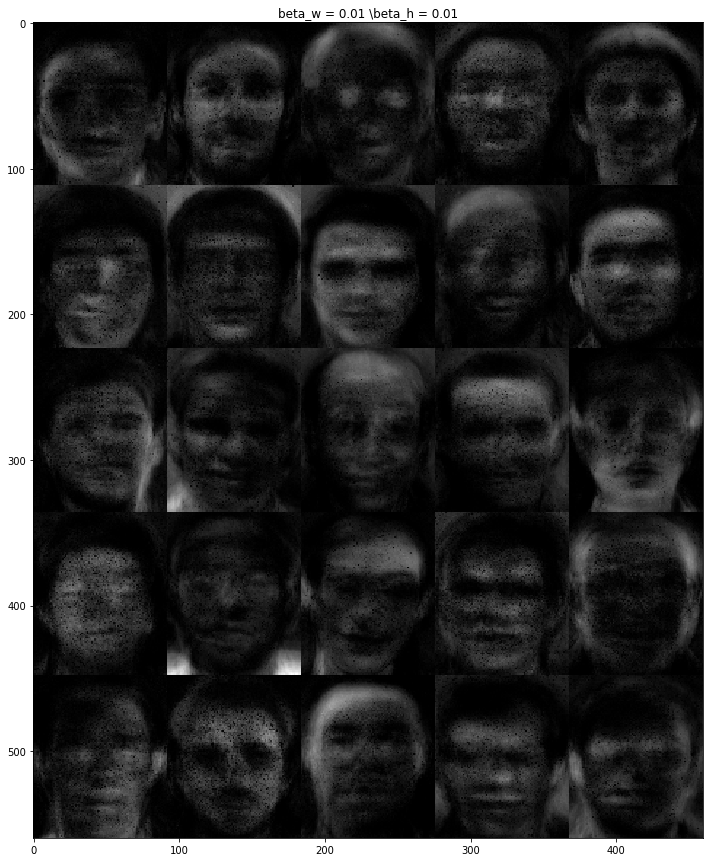

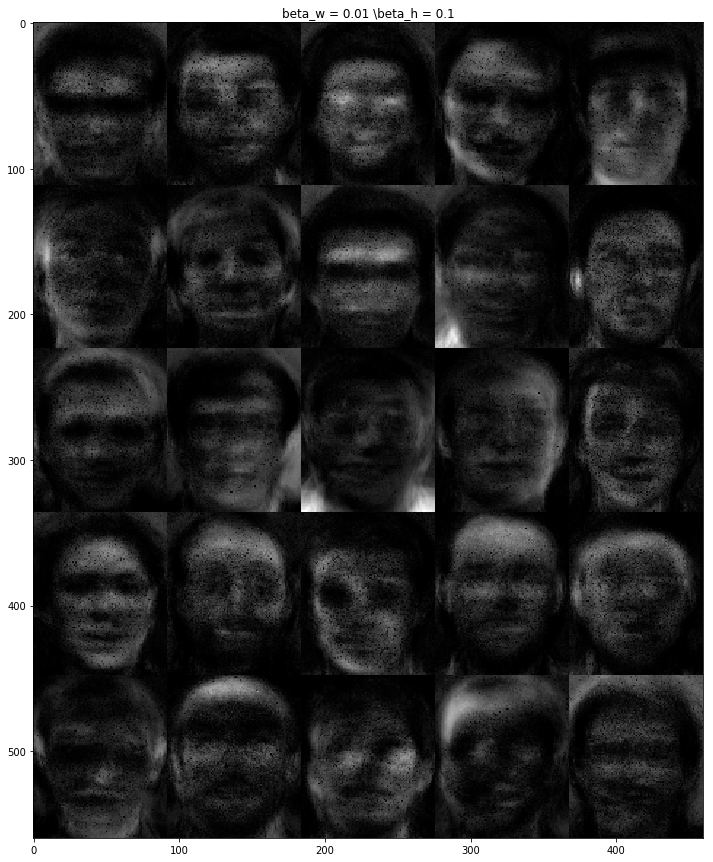

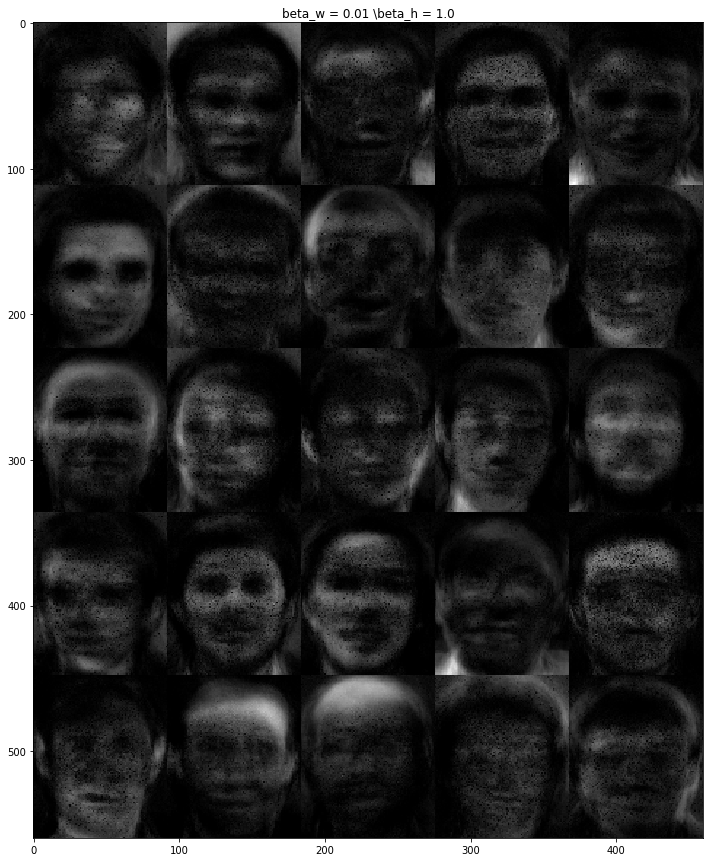

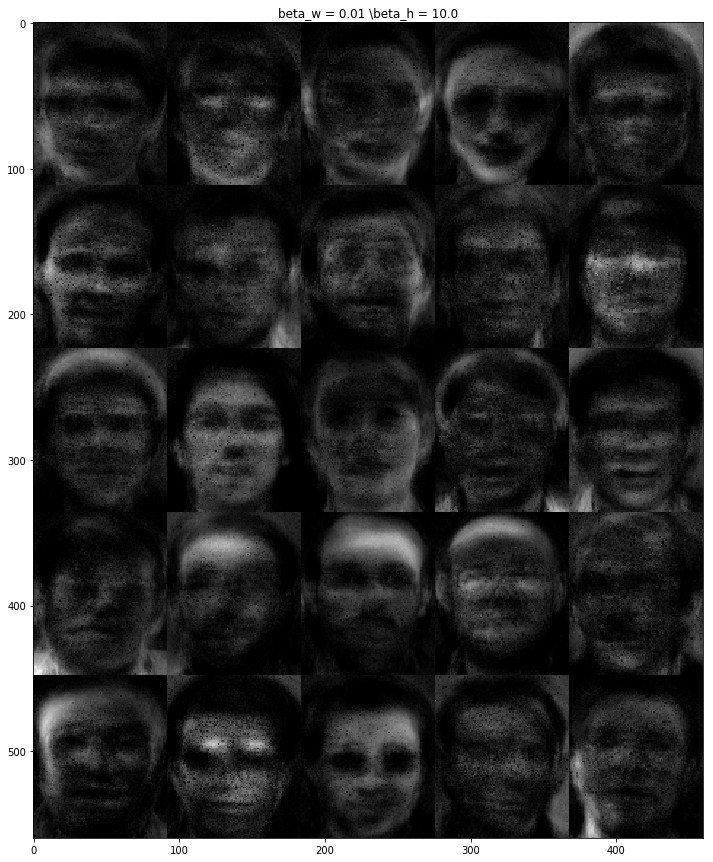

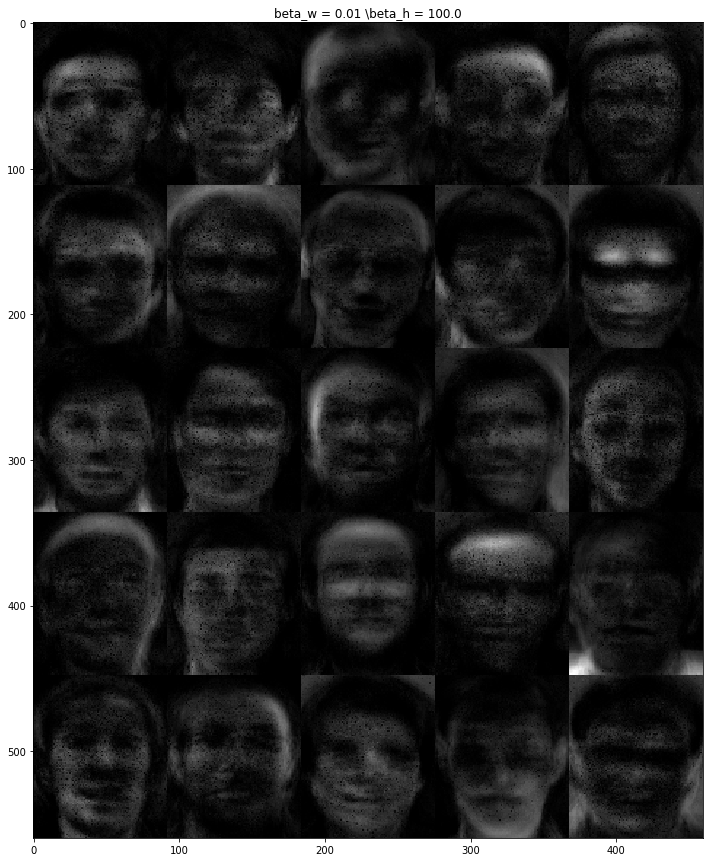

...

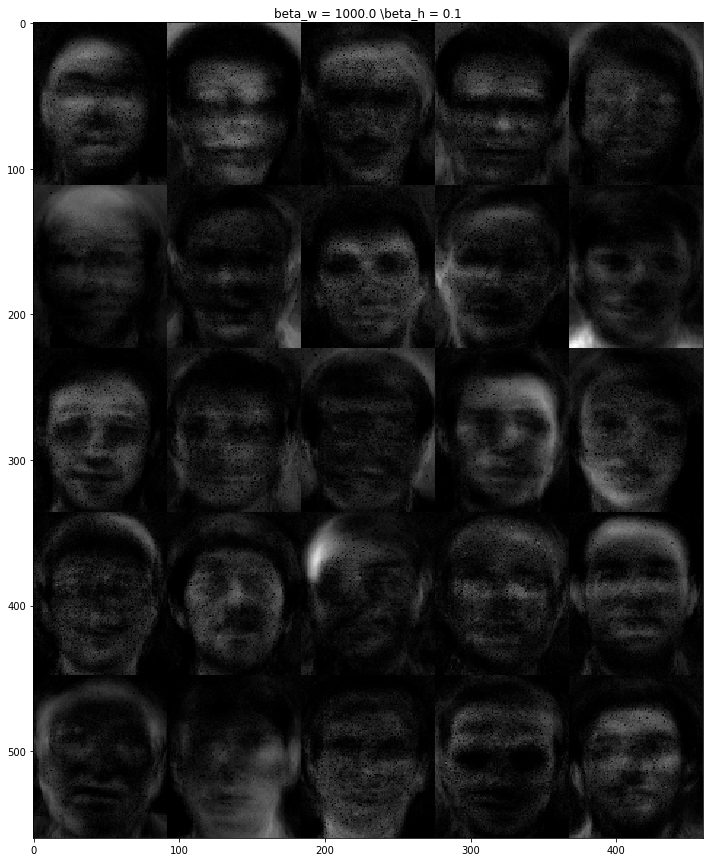

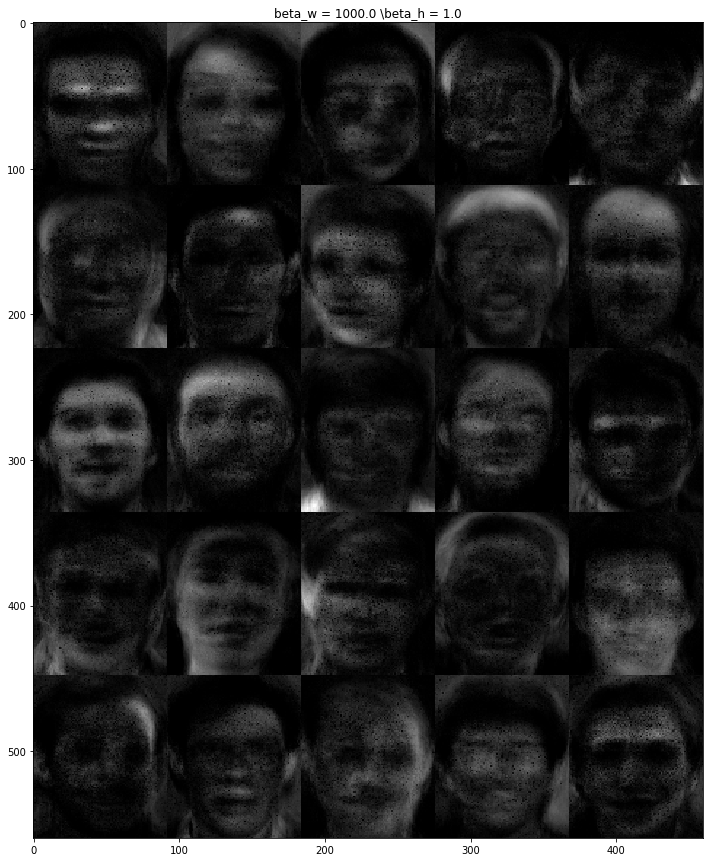

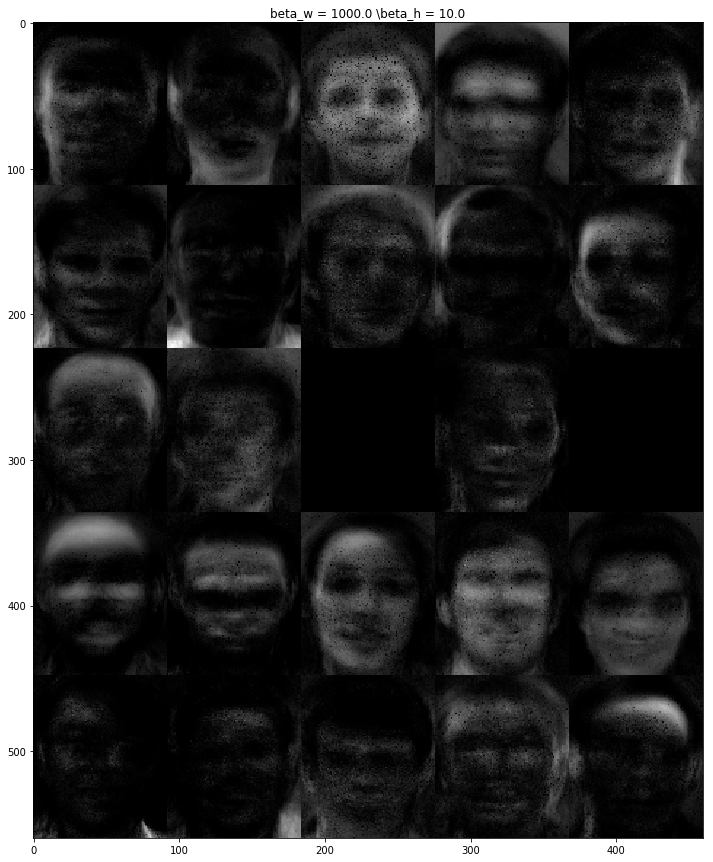

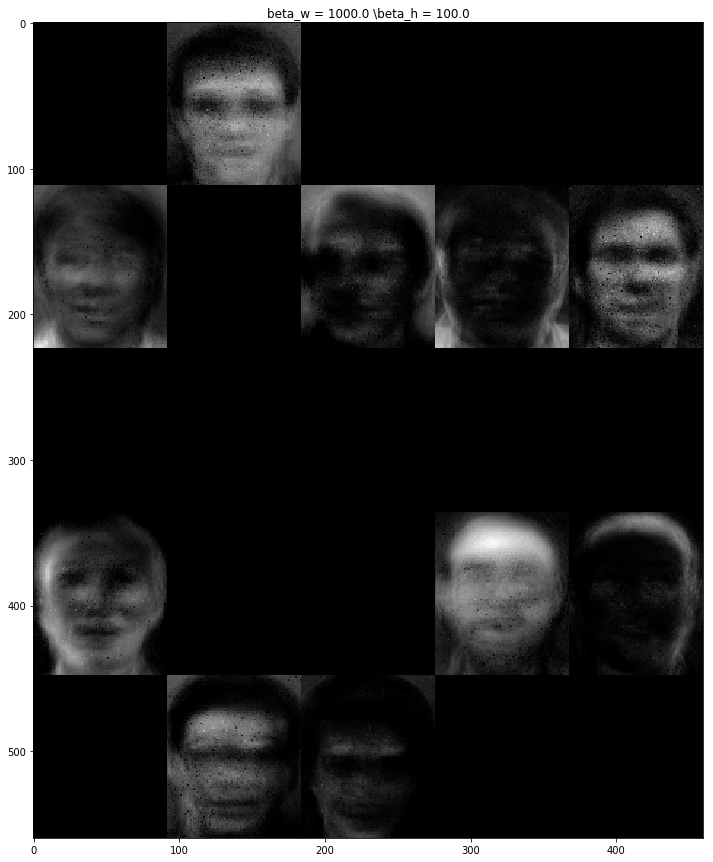

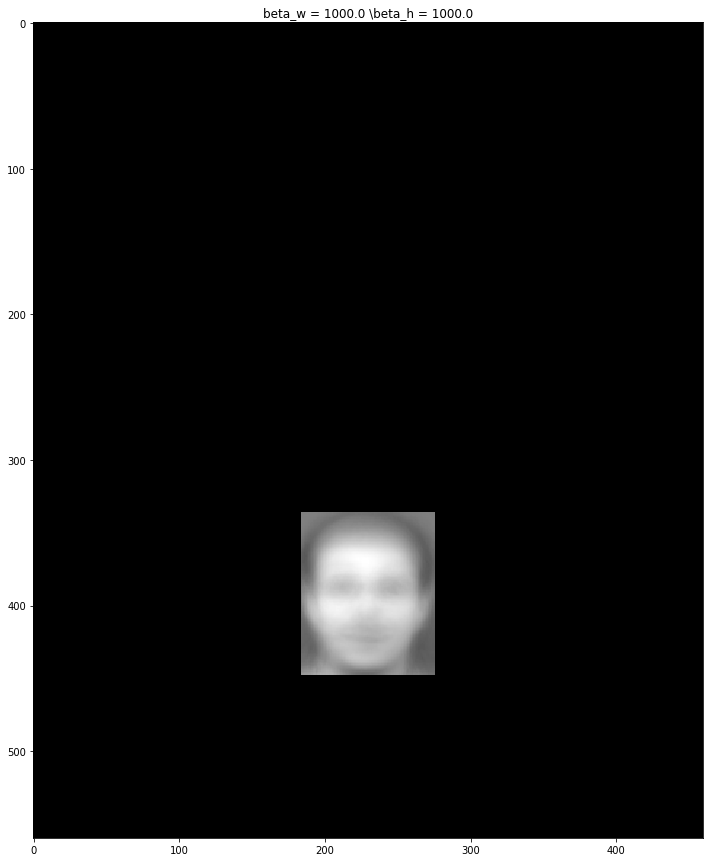

In [7]:
beta_w_val=np.logspace(-2.,3,num=6)
beta_h_val=np.logspace(-2.,3,num=6)
visualize(param_beta=True,beta_w_vect=beta_w_val,beta_h_vect=beta_h_val)

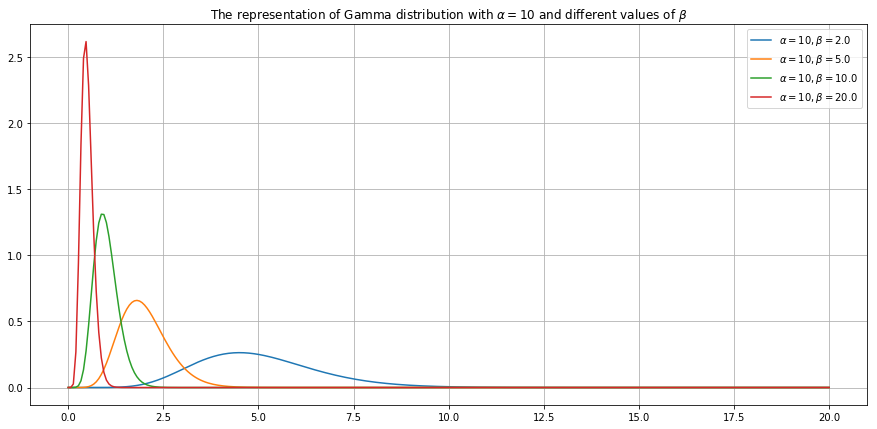

In [8]:
import seaborn as sns

x = np.linspace (0, 20, 300)
plt.figure(figsize=(15,7))
beta_values=[2.,5.,10.,20.]
for beta in beta_values :
    distibution = stats.gamma.pdf(x, a = 10, scale = 1./beta)
    plt.plot(x, distibution, "-", label=(r'$\alpha=%s, \beta=$%s')%(10,beta)) 

    
plt.grid(True)
plt.legend(loc = "best")
plt.title(r"The representation of Gamma distribution with $\alpha=10$ and different values of $\beta$")
plt.show()

**Observations**:

For the high values of $\beta_w$ and $\beta_h$, we can distinguish some features of the face like the eyes, the jaw, the nose, ... This is clearly visible for the figure having beta_w = 100 and beta_h = 100
but by further increasing the beta values. We can see that the images become totally dark. so the increase of $\beta_w$ and $\beta_h$ values tends to make the matrix sparse.

For low values of beta we get some fuzzy images. This can be explained by the fact that the matrices W and H are dense.

From the distribution above, we can see that the higher is the value of $\beta$, the higher will be the peak of the gamma distribution and the lower will be the scale parameter

### Question 3 : Run the algorithm with K = 25, $\beta_w$ = $\beta_h$ = 1. Try different values for $\alpha_w$ and $\alpha_h$ . Visualize the columns of estimated W matrices. What do you observe when you change the parameters?

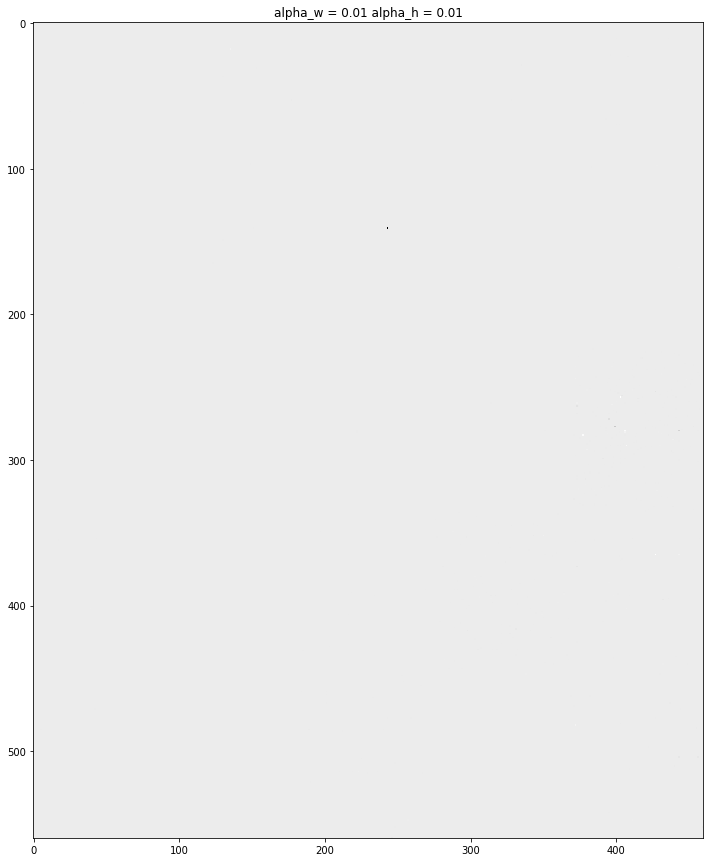

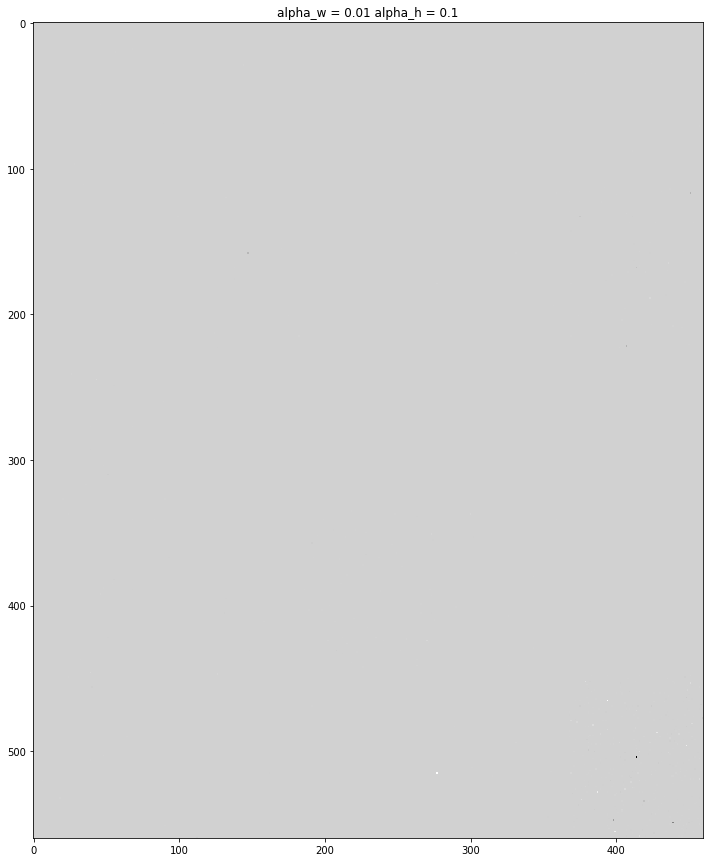

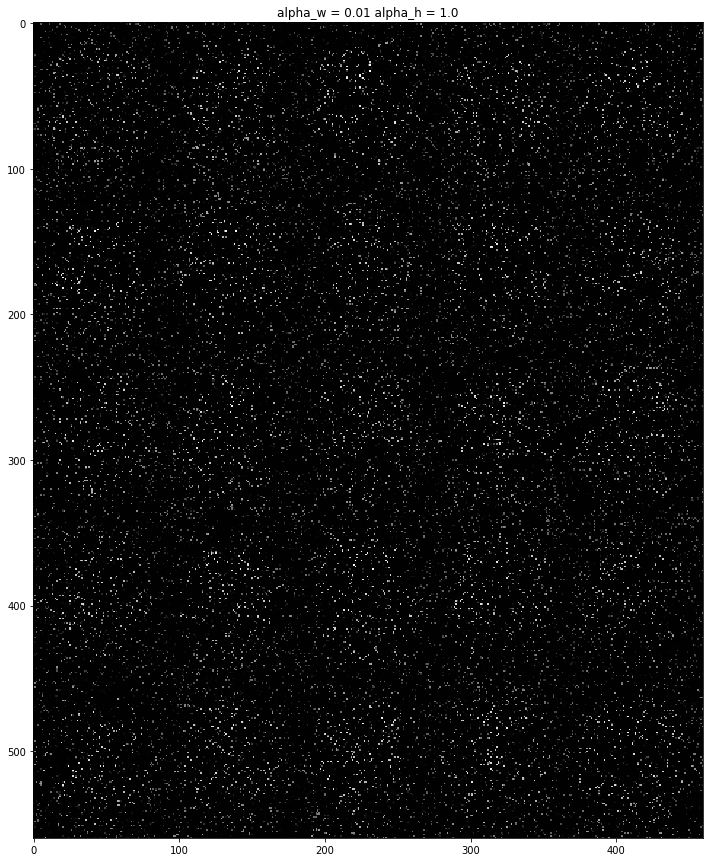

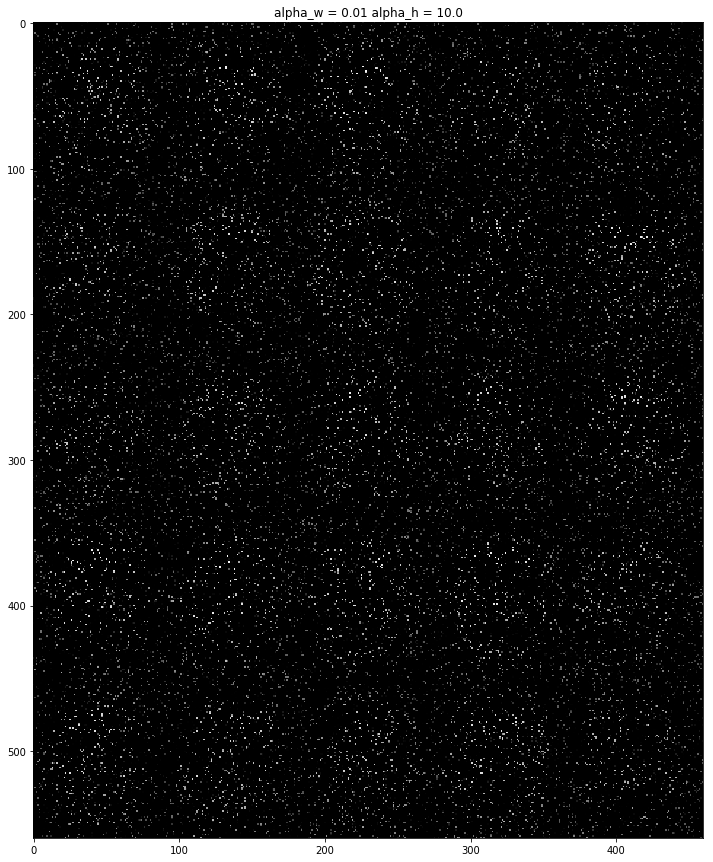

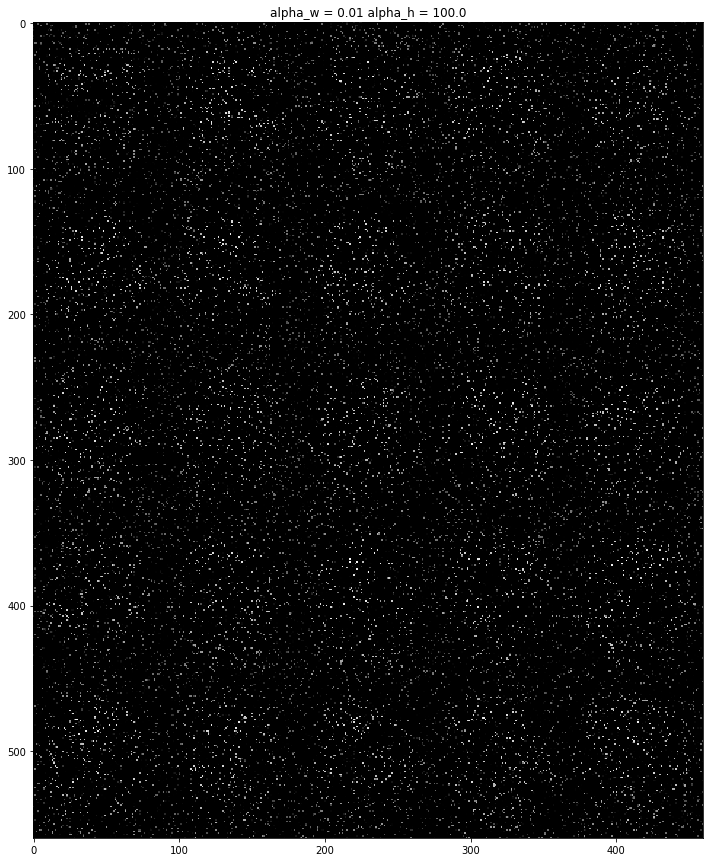

...

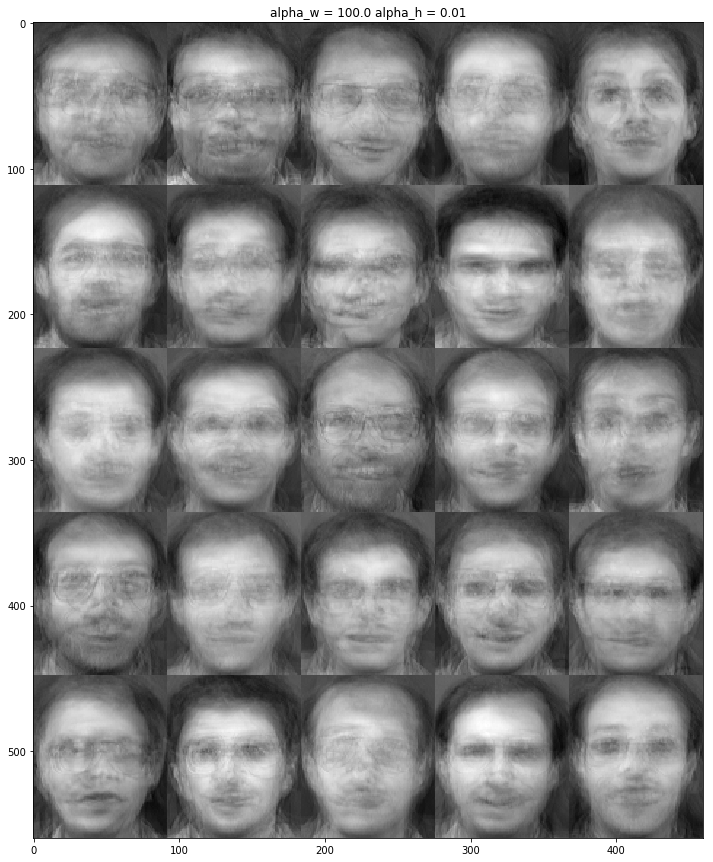

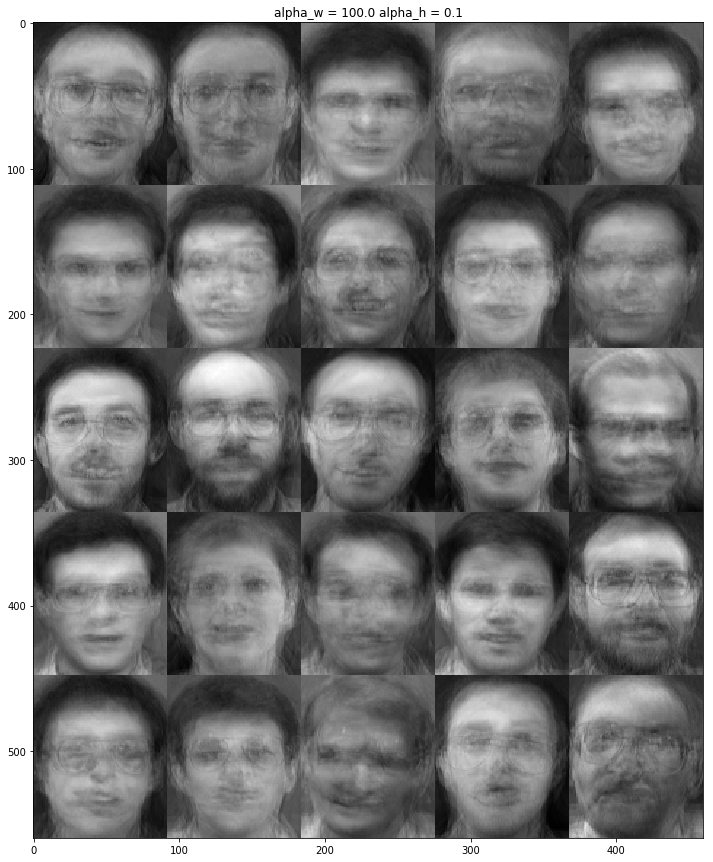

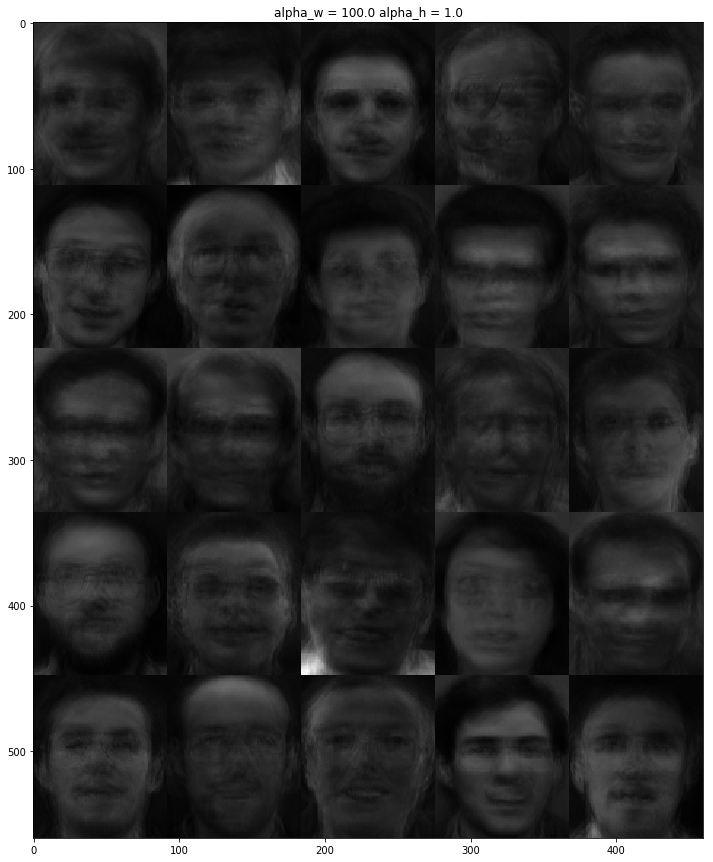

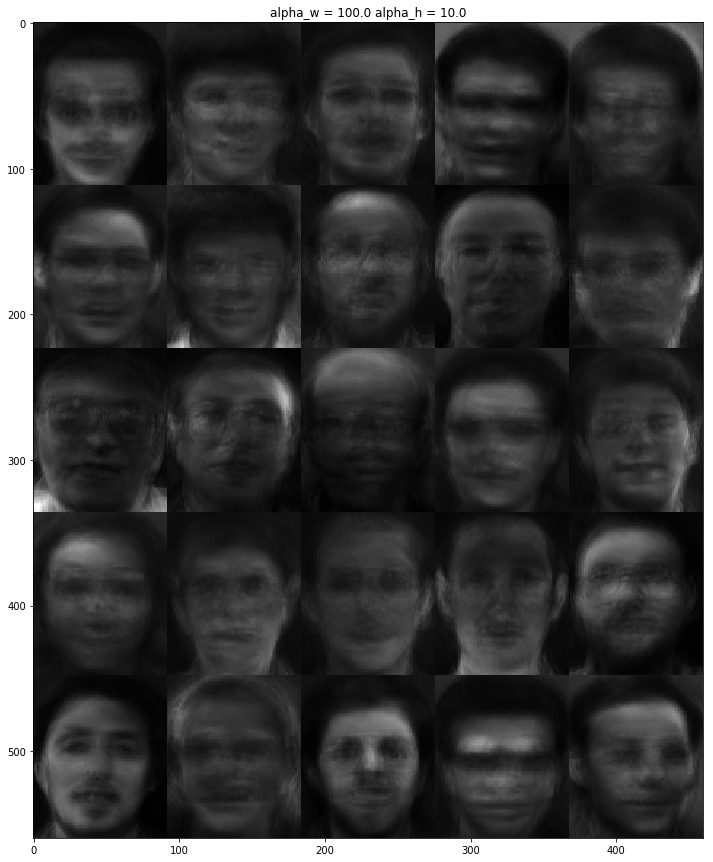

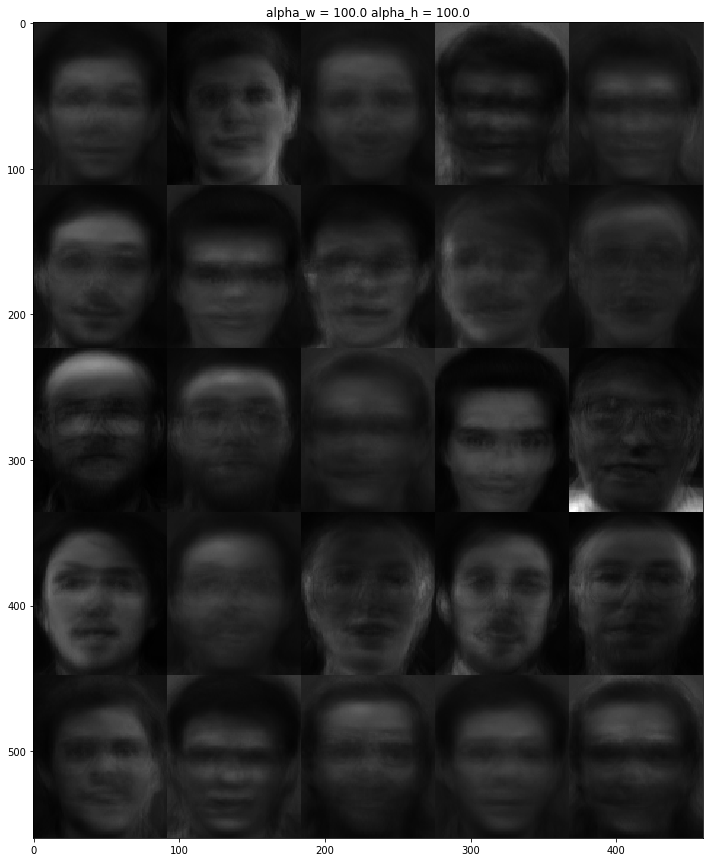

In [9]:
alpha_w_val=np.logspace(-2.,2,num=5)
alpha_h_val=np.logspace(-2.,2,num=5)
visualize(param_alpha=True,alpha_w_vect=alpha_w_val,alpha_h_vect=alpha_h_val)

**Observations** :

We can see that for low values of $\alpha_w$ and $\alpha_h$ (of the order of 1e-2) we observe a total opacity.

For alpha values greater than 1 we observe some facial feature.

The increase in the value of $\alpha_h$ tends to make the image dark. This shows that the increase of $\alpha_h$ makes the matrix W sparse.

By increasing the value of $\alpha_w$ the image becomes more and more clear.

### Question 4 : Now try changing the number of components K. What do you observe?

In [10]:
K_vect=np.arange(1,398,100)

Time of computation - K= : 1 3.798768997192383


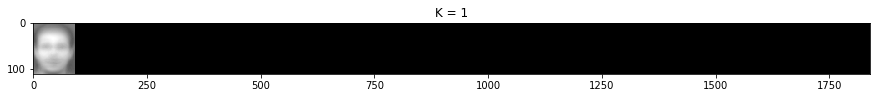

Time of computation - K= : 101 8.588118076324463


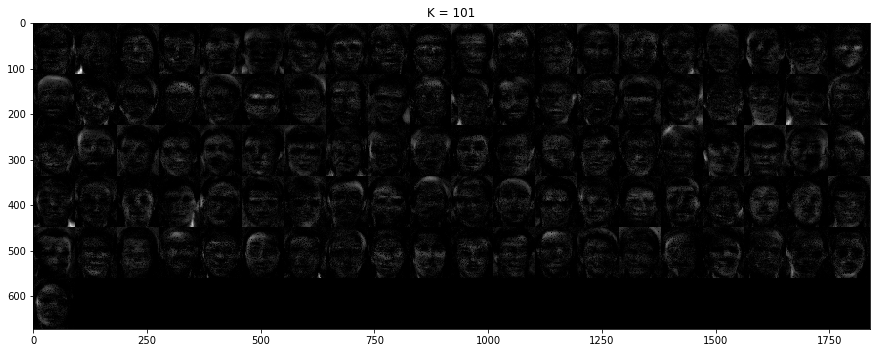

Time of computation - K= : 201 11.121359586715698


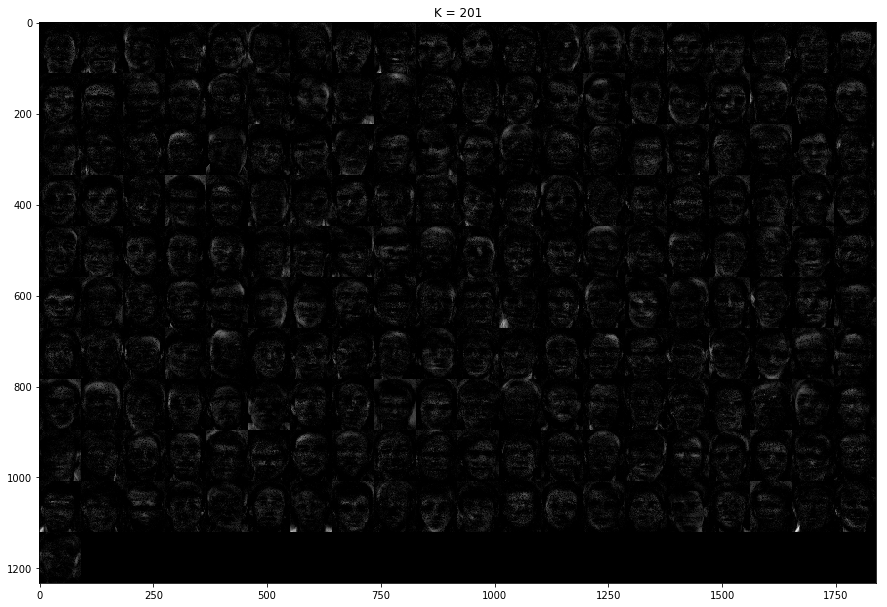

Time of computation - K= : 301 16.522744178771973


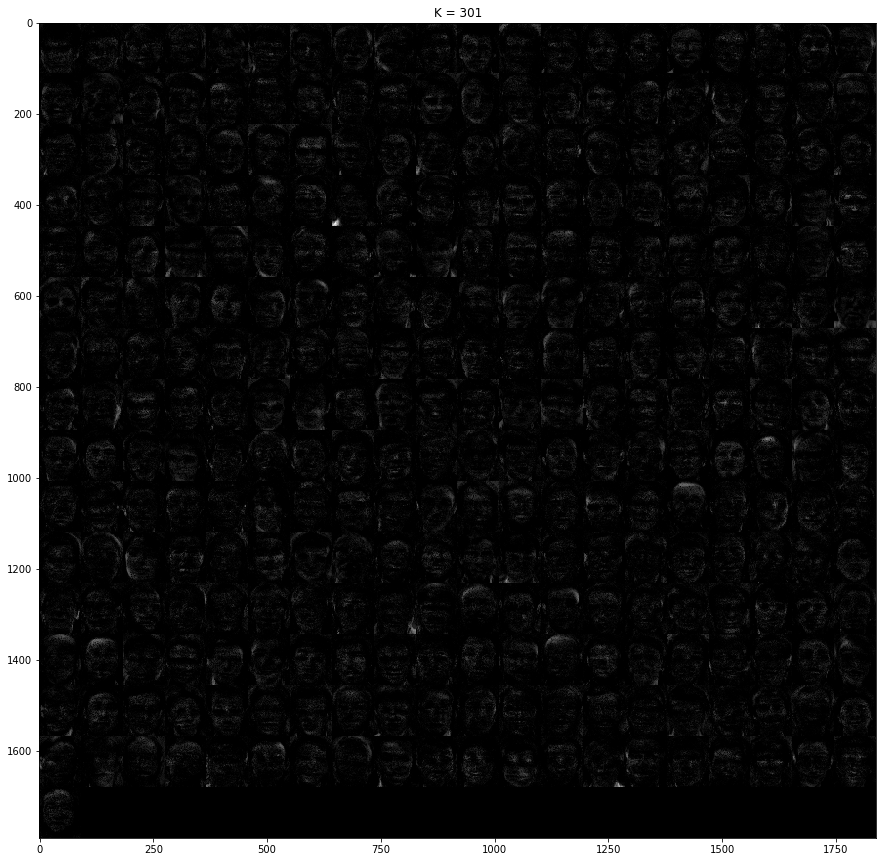

In [11]:
visualize(param_K=True,K_vect=K_vect)

**Observations:**
NB: the variation of K could give us a meaningless result. sometimes we have a sake of interpretability.

* The more we increases K the longer is the execution time of the algorithm. this is explained by the fact that the model becomes more and more complicated(harder to estimate, more parameters to transmit,...) 

* we can also notice that by increasing K, facial features become sharper even if the image is dark.So a greater K leads to a better approximation. Moreover with increasing the value of K we can observe more details in the picture that's means that we have more features.